# Setup

## Install libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

!pip install pydicom
!pip install nibabel
!pip install python-gdcm
!pip install pylibjpeg
!pip install pylibjpeg-libjpeg
!pip install pynrrd

MessageError: ignored

## Import libraries

In [ ]:
from glob import glob

import pydicom

from matplotlib import pyplot as plt
import numpy as np

## add shortcut of the sample data folder to your drive
dicom_path = 'drive/MyDrive/start/CT Segmentor/Technical/Notes/Brain CT Sample data/CT Plain'
# dicom_path = 'drive/My Drive/Brain CT Sample data/CT Plain'
nifti_path = 'drive/MyDrive/start/CT Segmentor/Technical/Notes/Brain CT Sample data/2_plain_5mm.nii'
# 'drive/My Drive/Brain CT Sample data/2_plain_5mm.nii'

dicom_files = glob(dicom_path+'/*')


# Load data

Here, we load some data samples from [CQ500](http://headctstudy.qure.ai/dataset).

Check out their [paper](https://arxiv.org/pdf/1803.05854.pdf) for the preprocessing steps, under Section 2.3.4.

> "For a given CT scan, we selected the **non-contrast** **axial** series which uses soft reconstruction kernel
and **resampled** it so that slice thickness is around 5mm. We then **resized** all the slices of this series to
a size of **224 × 224** pixels before passing to our deep learning models. Instead of passing the whole
dynamic range of CT densities as a single channel, we **windowed** the densities by using three separate
windows and stacking them as channels. Windows used were **brain window** (l = 40, w = 80), **bone
window** (l = 500, w = 3000) **and subdural window** (l = 175, w = 50). This was because fracture
visible in the bone window could indicate existence of an extra axial bleed in the brain window and
conversely, presence of scalp hematoma in the the brain window could correlate with a fracture.
Subdural window helps differentiate between the skull and an extra axial bleed that might have been
indistinguishable in a normal brain window."

Let's see if the dataset they uploaded is already in HU.

## DICOM (.dcm)

There will be a lot of information in the header.

Important ones to check are:
- Consistency of `(0018, 0050) Slice Thickness` across slices
- Whether `(0028, 1054) Rescale Type` is HU

In [ ]:
dcmfile = pydicom.dcmread(dicom_files[20])
dcmfile # uncomment to view header

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 200
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.296485376.1.1521714315.2034116
(0002, 0010) Transfer Syntax UID                 UI: JPEG Lossless, Non-Hierarchical, First-Order Prediction (Process 14 [Selection Value 1])
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.2
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_362'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL']
(0008, 0012) Instance Creation Date              DA: ''
(0008, 0013) Instance Creation Time              TM: ''
(0008, 0016) SOP Class UID                

In [ ]:
dcmfile[('0028','1050')].value # how to retrieve window centre from header ; window width is (0028, 1051)

'30.0'

In [ ]:
dcmfile.RescaleType # another way to get common metadata from header

'HU'

In [ ]:
dcmfile.pixel_array, dcmfile.pixel_array.shape # data has the shape 512 x 512

(array([[-2000, -2000, -2000, ..., -2000, -2000, -2000],
        [-2000, -2000, -2000, ..., -2000, -2000, -2000],
        [-2000, -2000, -2000, ..., -2000, -2000, -2000],
        ...,
        [-2000, -2000, -2000, ..., -2000, -2000, -2000],
        [-2000, -2000, -2000, ..., -2000, -2000, -2000],
        [-2000, -2000, -2000, ..., -2000, -2000, -2000]], dtype=int16),
 (512, 512))

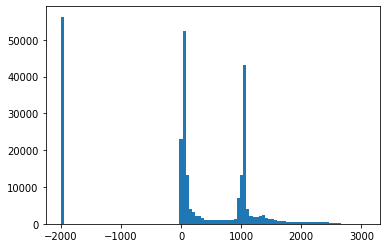

In [ ]:
hist = plt.hist(dcmfile.pixel_array.reshape(-1), bins=100) # check the range of the dataset

### Notice that there are many values at -2000.
We know that HU values are only defined for values [-1024, 3071]. What happened?

> "Values less than −1024 HU are commonly found due to areas of the image outside the field of view that were not actually imaged. One first processing step would be to Winsorize the data to the [−1024, 3"071] range. After this step, the header elements **`scl_slope` and `scl_inter` elements of the NIfTI image should be set to 1 and 0**, respectively, to ensure no data rescaling is done in other software."

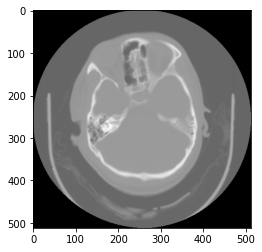

In [ ]:
plt.imshow(dcmfile.pixel_array, cmap='gray') # notice the bed. axial slice

From the plot, you can see that the CT scan's FOV is a circle. Since images are stored in 2D (square), they have given the area in the square but outside the circular FOV another value (-2000). Let's change it: set -2000 to 0.

In [ ]:
def winsorise_image(raw_dcm):
    raw_data = raw_dcm.pixel_array.copy()
    raw_data[raw_data == -2000] = 0
    return raw_data

def rescale_image(raw_dcm, image_data):
    return (image_data * raw_dcm.RescaleSlope) + raw_dcm.RescaleIntercept


In [ ]:
# winsorised_data = dcmfile.pixel_array.copy()
# winsorised_data[winsorised_data == -2000] = 0

winsorised_data = winsorise_image(dcmfile)
print('org', dcmfile.pixel_array.min(), dcmfile.pixel_array.max())
print('new', winsorised_data.min(), winsorised_data.max())

org -2000 3062
new 0 3062


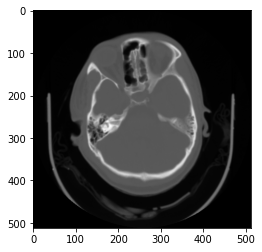

In [ ]:
plt.imshow(winsorised_data, cmap='gray') # notice that the grey circle is gone!

In [ ]:
# rescaled = (winsorised_data * dcmfile.RescaleSlope) + dcmfile.RescaleIntercept
rescaled = rescale_image(dcmfile, winsorised_data)
rescaled.min(), rescaled.max()

(-1024.0, 2038.0)

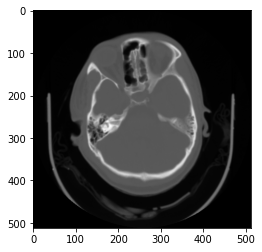

In [ ]:
plt.imshow(rescaled, cmap='gray') # rescaling doesn't affect relative intensity

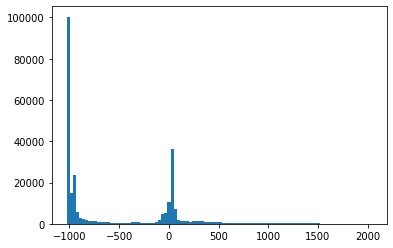

In [ ]:
hist_rescaled = plt.hist(rescaled.reshape(-1), bins=100) # check the range of the dataset

## NifTI (.nii)

In [ ]:
import nibabel as nib

nifti_im = nib.load(nifti_path)

In [ ]:
nifti_im.header

In [ ]:
arr = nifti_im.get_fdata()
print(arr.shape) # 30 slices

(231, 254, 30)


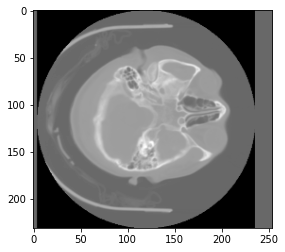

In [ ]:
plt.imshow(arr[:,:,5], cmap='gray') # this was intentionally rotated

# Process data

In [ ]:
def get_first_of_dicom_field_as_int(x):
    #get x[0] as in int is x is a 'pydicom.multival.MultiValue', otherwise get int(x)
    if type(x) == pydicom.multival.MultiValue:
        return int(x[0])
    else:
        return int(x)

def get_scaling_params(data):
    dicom_fields = [data[('0028','1050')].value, #window center
                    data[('0028','1051')].value, #window width
                    data[('0028','1052')].value, #intercept
                    data[('0028','1053')].value] #slope
    return [get_first_of_dicom_field_as_int(x) for x in dicom_fields]

def rescale_and_window_image(org, window_center,window_width, intercept, slope):
    img = org.copy()
    img = (img*slope + intercept)
    img_min = window_center - window_width//2
    img_max = window_center + window_width//2
    img[img<img_min] = img_min
    img[img>img_max] = img_max
    return img

def window_image(org, window_center, window_width):
    img = org.copy()
    img_min = window_center - window_width//2
    img_max = window_center + window_width//2
    img[img<img_min] = img_min
    img[img>img_max] = img_max
    return img


## Remove bed

Code obtained from [this article](https://towardsdatascience.com/medical-image-pre-processing-with-python-d07694852606).

In [ ]:
from skimage import morphology

import numpy as np

import scipy

def generate_brain_mask(windowed):

    '''
    Seems to need brain window to work
    '''

    segmentation = morphology.dilation(windowed, np.ones((1, 1)))
    labels, label_nb = scipy.ndimage.label(segmentation)

    label_count = np.bincount(labels.ravel().astype(np.int))
    label_count[0] = 0

    mask = labels == label_count.argmax()
    mask = morphology.dilation(mask, np.ones((1, 1)))
    mask = scipy.ndimage.morphology.binary_fill_holes(mask)
    mask = morphology.dilation(mask, np.ones((3, 3)))

    return mask

windowed = window_image(rescaled, 40, 80)
mask = generate_brain_mask(windowed)
masked_image = mask * windowed
masked_image_raw = mask * rescaled

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  app.launch_new_instance()


In [ ]:
mask.sum(), mask.shape, mask.sum()/(mask.shape[0]*mask.shape[1])

(80764, (512, 512), 0.3080902099609375)

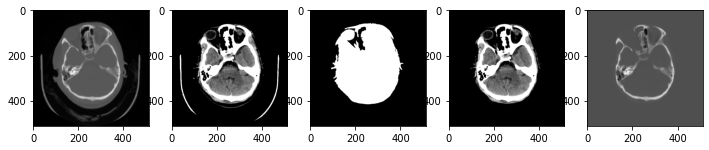

In [ ]:
f, axarr = plt.subplots(1,5, figsize=(12, 12))
axarr[0].imshow(rescaled, cmap='gray')
axarr[1].imshow(windowed, cmap='gray')
axarr[2].imshow(mask, cmap='gray')
axarr[3].imshow(masked_image, cmap='gray')
axarr[4].imshow(masked_image_raw, cmap='gray')
# plt.imshow(mask, cmap='gray')
# plt.imshow(masked_image, cmap='gray')

## Resampling

Voxels (3D pixel) might not be **isotropic**: pixel dimensions and slice distance (slice thickness and gap between slices) could be different.

To resolve this, resampling can be performed to make sure these are consistent (i) across slices within a scan and (ii) across multiple scans.

> Performing this operation will **change the size of the original image**.

In [ ]:
import numpy as np
import scipy.ndimage

def resample(org, scan, new_spacing=[1,1,1]):
    '''
    From https://www.kaggle.com/code/akh64bit/full-preprocessing-tutorial/notebook
    scan refers to the dcmfile
    image refers to dcm.pixel_array (image data)
    '''

    image = org.copy()

    # Determine current pixel spacing
    spacing = map(float, ([scan.SliceThickness] + list(scan.PixelSpacing)))
    spacing = np.array(list(spacing))
    print('Slice Thickness:', scan.SliceThickness)
    print('Pixel Spacing:', scan.PixelSpacing)
    # assert scan.PixelSpacing[0] == scan.PixelSpacing[1]

    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor

    print('original shape', image.shape)
    print('new_shape', new_shape)
    print('new_spacing', new_spacing)

    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor)
    print('new shape', image.shape)

    return image, new_spacing

In [ ]:
# need to load the entire volume, not just a single .dcm file (a slice)

dcmfiles = [pydicom.dcmread(f) for f in sorted(dicom_files)]
dcmfiles = sorted(dcmfiles, key=lambda s: s.SliceLocation) #sort slices in correct order


rescaled_vol = []
for dcm in dcmfiles:
  winsor_data = winsorise_image(dcm)
  rescaled_data = rescale_image(dcm, winsor_data)

  windowed = window_image(rescaled_data, 40, 80)
  mask = generate_brain_mask(windowed)
  masked_image_raw = mask * rescaled_data
  rescaled_vol.append(masked_image_raw) # so that the bed is not inside

rescaled_vol = np.asarray(rescaled_vol)

resampled_vol, resampled_size = resample(rescaled_vol, dcm)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  app.launch_new_instance()


Slice Thickness: 5.000000
Pixel Spacing: [0.451172, 0.451172]
original shape (30, 512, 512)
new_shape [150. 231. 231.]
new_spacing [1.         1.00000028 1.00000028]
new shape (150, 231, 231)


In [ ]:
# need to load the entire volume, not just a single .dcm file (a slice)

dcmfiles = [pydicom.dcmread(f) for f in sorted(dicom_files)]
dcmfiles = sorted(dcmfiles, key=lambda s: s.SliceLocation) #sort slices in correct order


rescaled_vol = []
for dcm in dcmfiles:
  winsor_data = winsorise_image(dcm)
  rescaled_data = rescale_image(dcm, winsor_data)

  windowed = window_image(rescaled_data, 40, 80)
  mask = generate_brain_mask(windowed)
  masked_image_raw = mask * windowed
  rescaled_vol.append(masked_image_raw) # so that the bed is not inside

rescaled_vol = np.asarray(rescaled_vol)

resampled_vol, resampled_size = resample(rescaled_vol, dcm)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  app.launch_new_instance()


Slice Thickness: 5.000000
Pixel Spacing: [0.451172, 0.451172]
original shape (30, 512, 512)
new_shape [150. 231. 231.]
new_spacing [1.         1.00000028 1.00000028]
new shape (150, 231, 231)


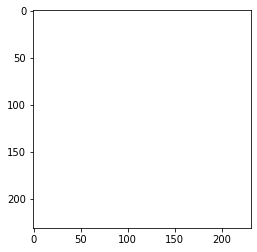

In [ ]:
#AXIAL
from matplotlib import animation, rc


ims = []
fig = plt.figure()
for i in range(resampled_vol.shape[0]):
  im = plt.imshow(resampled_vol[i], animated=True, cmap='gray')
  ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=20)
rc('animation', html='jshtml')
ani

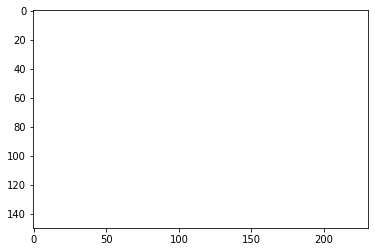

In [ ]:
#CORoNAL
from matplotlib import animation, rc


ims = []
resampled_vol_sagittal = resampled_vol[::-1,:,:]
fig = plt.figure()
for i in range(resampled_vol_sagittal.shape[1]):
  im = plt.imshow(resampled_vol_sagittal[:,i,:], animated=True, cmap='gray')
  ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=20)

rc('animation', html='jshtml')
ani

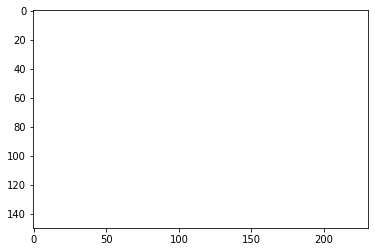

In [ ]:
#sagittal
from matplotlib import animation, rc


ims = []
resampled_vol_coronal = resampled_vol[::-1,:,:]
fig = plt.figure()
for i in range(resampled_vol_coronal.shape[1]):
  im = plt.imshow(resampled_vol_coronal[:,:,i], animated=True, cmap='gray')
  ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=20)
rc('animation', html='jshtml')
ani

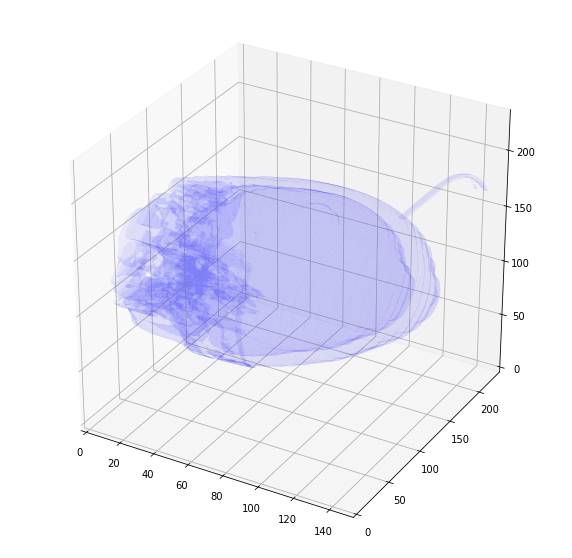

In [ ]:
# View 3D, for fun.
# From https://www.kaggle.com/code/akh64bit/full-preprocessing-tutorial/notebook

from skimage import measure
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

def plot_3d(image, threshold=-300):

    # Position the scan upright,
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(1,2,0)
    p = p[:,:,::-1]
    p = image

    verts, faces, normals, values = measure.marching_cubes(p, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.1)
    face_color = [0.5, 0.5, 1]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])

    plt.show()

plot_3d(resampled_vol, 100) # brain window


## Gantry Tilt

In [ ]:
!apt-get install dcm2niix

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  libyaml-cpp0.5v5
Suggested packages:
  pigz
The following NEW packages will be installed:
  dcm2niix libyaml-cpp0.5v5
0 upgraded, 2 newly installed, 0 to remove and 45 not upgraded.
Need to get 295 kB of archives.
After this operation, 1,105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libyaml-cpp0.5v5 amd64 0.5.2-4ubuntu1 [150 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 dcm2niix amd64 1.0.20171215-1 [145 kB]
Fetched 295 kB in 1s (421 kB/s)
Selecting previously unselected package libyaml-cpp0.5v5:amd64.
(Reading database ... 155632 files and directories currently installed.)
Preparing to unpack .../libyaml-cpp0.5v5_0.5.2-4ubunt

In [ ]:
!dcm2niix

Compression will be faster with 'pigz' installed
Chris Rorden's dcm2niiX version v1.0.20171215 (OpenJPEG build) GCC7.3.0 (64-bit Linux)
usage: dcm2niix [options] <in_folder>
 Options :
  -1..-9 : gz compression level (1=fastest..9=smallest, default 6)
  -b : BIDS sidecar (y/n/o(o=only: no NIfTI), default y)
   -ba : anonymize BIDS (y/n, default y)
  -c : comment stored as NIfTI aux_file (up to 24 characters)
  -d : diffusion volumes sorted by b-value (y/n, default n)
  -f : filename (%a=antenna  (coil) number, %c=comments, %d=description, %e echo number, %f=folder name, %i ID of patient, %j seriesInstanceUID, %k studyInstanceUID, %m=manufacturer, %n=name of patient, %p=protocol, %s=series number, %t=time, %u=acquisition number, %v=vendor, %x=study ID; %z sequence name; default '%f_%p_%t_%s')
  -h : show help
  -i : ignore derived, localizer and 2D images (y/n, default n)
  -m : merge 2D slices from same series regardless of study time, echo, coil, orientation, etc. (y/n, default n)
  -

In [ ]:
for i, dcm in enumerate(dcmfiles):
  print(i, dcm[('0018','1120')].value)



0 9.000000
1 9.000000
2 9.000000
3 9.000000
4 9.000000
5 9.000000
6 9.000000
7 9.000000
8 9.000000
9 9.000000
10 9.000000
11 9.000000
12 9.000000
13 9.000000
14 9.000000
15 9.000000
16 9.000000
17 9.000000
18 9.000000
19 9.000000
20 9.000000
21 9.000000
22 9.000000
23 9.000000
24 9.000000
25 9.000000
26 9.000000
27 9.000000
28 9.000000
29 9.000000


In [ ]:
#show slice thickness of all slices
dcmfiles = [pydicom.dcmread(f) for f in sorted(dicom_files)]
dcmfiles = sorted(dcmfiles, key=lambda s: s.SliceLocation) #sort slices in correct order

seriesid = []
for i, dcm in enumerate(dcmfiles):
  seriesid += [dcm.SeriesInstanceUID]
  s = f"Slice thickness of slice {i} (Series no {dcm.SeriesNumber}), {dcm[('0018' , '0050')].value}."
  if i > 0:
    # s += f" Slice thickness from location : {np.abs(dcmfiles[i].ImagePositionPatient[-1] - dcmfiles[i-1].ImagePositionPatient[-1])}"
    s += f" Slice thickness from location : {np.abs(dcmfiles[i].SliceLocation - float(dcmfiles[i-1].SliceLocation))}"
  print(s)

#for an arbitrary folder of dicom, must check series ID before sorting
assert len(set(seriesid))==1, 'Multiple Series ID'




Slice thickness of slice 0 (Series no 2), 5.000000.
Slice thickness of slice 1 (Series no 2), 5.000000. Slice thickness from location : 5.062
Slice thickness of slice 2 (Series no 2), 5.000000. Slice thickness from location : 5.063
Slice thickness of slice 3 (Series no 2), 5.000000. Slice thickness from location : 5.061999999999999
Slice thickness of slice 4 (Series no 2), 5.000000. Slice thickness from location : 5.063000000000001
Slice thickness of slice 5 (Series no 2), 5.000000. Slice thickness from location : 5.061999999999999
Slice thickness of slice 6 (Series no 2), 5.000000. Slice thickness from location : 5.062999999999999
Slice thickness of slice 7 (Series no 2), 5.000000. Slice thickness from location : 5.062000000000001
Slice thickness of slice 8 (Series no 2), 5.000000. Slice thickness from location : 5.062999999999999
Slice thickness of slice 9 (Series no 2), 5.000000. Slice thickness from location : 5.062000000000001
Slice thickness of slice 10 (Series no 2), 5.000000. S

In [ ]:
!dcm2niix

# Load Mask

In [ ]:
# Load another data file

import os

dcmfile2_path = os.path.join(
    os.path.dirname(dicom_path),
    'CQ500-Unzip_479_Unknown+Study_CT+PRE+CONTRAST+5MM+STD_CT000019.dcm')

dcmfile2 = pydicom.dcmread(dcmfile2_path)
window_center , window_width, intercept, slope = get_scaling_params(dcmfile2)
print('wl/ww', window_center, window_width)
print('slope and intercept', slope, intercept)

dcmfile2.pixel_array.min(), dcmfile2.pixel_array.max()

wl/ww 40 100
slope and intercept 1 -1024


(-2000, 2426)

In [ ]:
winsorised_data2 = dcmfile2.pixel_array.copy()
winsorised_data2[winsorised_data2 < -1024] = -1024

windowed_data2 = rescale_and_window_image(
    winsorised_data2, window_center, window_width, intercept, slope)

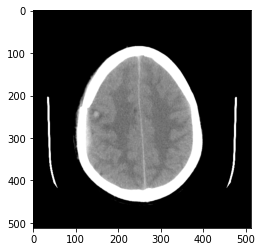

In [ ]:
plt.imshow(windowed_data2, cmap='gray')

In [ ]:
import nrrd

mask = nrrd.read(os.path.join(os.path.dirname(dicom_path),'Segmentation.nrrd'))
mask[0][:,:,-1].T


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int16)

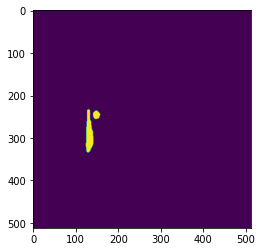

In [ ]:
plt.imshow(mask[0][:,:,-1].T)

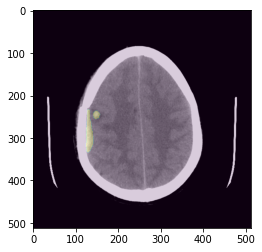

In [ ]:
# Image with mask

plt.imshow(dcmfile2.pixel_array, cmap='gray')
plt.imshow(mask[0][:,:,-1].T, alpha=0.2)

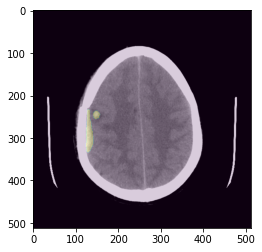

In [ ]:
plt.imshow(windowed_data2, cmap='gray')
plt.imshow(mask[0][:,:,-1].T, alpha=0.2)